## Objective

Comparision of KMeans and HDBSCAN 

In [1]:
# from googleapiclient.discovery import build
# from googleapiclient.errors import HttpError
# from google.oauth2.credentials import Credentials
# import io
# from googleapiclient.http import MediaIoBaseDownload

# creds = Credentials.from_authorized_user_file('token.json', SCOPES)

# # Find the file you want to download
# query = "name = 'example_file.csv'"
# drive_service = build('drive', 'v3', credentials=creds)
# results = drive_service.files().list(q=query).execute()

# # Download the file
# file_id = results['files'][0]['id']
# request = drive_service.files().get_media(fileId=file_id)
# file = io.BytesIO()
# downloader = MediaIoBaseDownload(file, request)
# done = False
# while done is False:
#     status, done = downloader.next_chunk()
#     print("Download %d%%." % int(status.progress() * 100))

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib
from copy import deepcopy
import numpy as np
import pandas as pd
from sentence_transformers import SentenceTransformer
from bertopic import BERTopic
from datasets import load_dataset
from umap import UMAP
import re
from hdbscan import HDBSCAN
from bertopic.representation import KeyBERTInspired
from sklearn.cluster import KMeans
from sklearn.feature_extraction.text import CountVectorizer
import plotly.io as pio
pio.renderers.default = 'iframe'

In [35]:
class EmbeddingsClusterTopics:
    def __init__(self, model_name, dataset_path, documents_column_name, embeddings_column_name, clustering_type = 'hdbscan', random_state = None):
        self.model_name = model_name
        self.embeddings_model = SentenceTransformer(self.model_name)
        custom_umap_model = UMAP(n_neighbors=15, n_components=10, random_state=random_state)  # Change 10 to the desired number of dimensions
        if clustering_type == 'hdbscan':
            custom_hdbscan_model = HDBSCAN(metric = 'manhattan')
        elif clustering_type == 'kmeans':
            custom_hdbscan_model = KMeans(n_clusters=25, random_state=random_state)
        vectorizer_model = CountVectorizer(stop_words="english", min_df=2, ngram_range=(1, 2))
        #representation_model = KeyBERTInspired()
        self.bertopic_model = BERTopic(nr_topics='auto',umap_model=custom_umap_model, hdbscan_model = custom_hdbscan_model, vectorizer_model=vectorizer_model)
        self.dataset = load_dataset('parquet',data_files =dataset_path)['train']
        self.documents = self._load_documents_from_parquet(documents_column_name)
        self.documents = [self._remove_numeric_words(doc) for doc in self.documents]
        self.embeddings = self._load_embeddings_from_parquet(embeddings_column_name)
        self.create_clusters_topics()
        self.generate_topic_names()

    def _remove_numeric_words(self, text):
        # Remove currency-based numbers like $123.1, currency symbols like €, and rupee symbol ₹
        currency_pattern = r'\$\s*\d+(\.\d+)?|\€\s*\d+(\.\d+)?|₹\s*\d+(\.\d+)?'

        # Match numeric words or currency-based numbers
        numeric_pattern = r'\b\d+(\.\d+)?\b'

        # Combine both patterns using negative lookahead to exclude percentages
        combined_pattern = rf'(?!(?:\d+(\.\d+)?%))({currency_pattern}|{numeric_pattern})'

        cleaned_text = re.sub(combined_pattern, '', text)
        return cleaned_text

    def _load_embeddings_from_parquet(self, embeddings_column_name):
        return np.array(self.dataset[embeddings_column_name])

    def _load_documents_from_parquet(self, documents_column_name):
        return self.dataset[documents_column_name]

    def create_clusters_topics(self):
        topics, _ = self.bertopic_model.fit_transform(documents = self.documents, embeddings = self.embeddings)
        self.hierarchical_topics = self.bertopic_model.hierarchical_topics(self.documents)

    def generate_topic_names(self):
        return self.bertopic_model.generate_topic_labels(nr_words=5, separator=", ")

    def reduce_clusters(self):
        return self.bertopic_model.reduce_topics(self.documents, nr_topics = 12)

In [215]:
# folder_path = 'Embeddings/'
# file = 'formatted_articles_data_2023_embeddings_gte_small.parquet'
# ect_gte_small = EmbeddingsClusterTopics(model_name = 'thenlper/gte-small', dataset_path = folder_path + file, documents_column_name = 'title_summary',embeddings_column_name = 'embeddings')

## Using KMEANS

In [38]:
folder_path = 'Embeddings/'
file = 'formatted_articles_data_2023_embeddings_bge_small_en.parquet'
ect_bge_small = EmbeddingsClusterTopics(model_name = 'BAAI/bge-small-en', 
                                        dataset_path = folder_path + file, 
                                        documents_column_name = 'title_summary',
                                        embeddings_column_name = 'embeddings', 
                                        clustering_type='kmeans',
                                        random_state=86)

100%|██████████| 20/20 [00:00<00:00, 173.13it/s]


In [37]:
ect_bge_small.bertopic_model.visualize_topics()

In [40]:
num_points = {}
for k in ect_bge_small.bertopic_model.topics_:
    num_points[ect_bge_small.bertopic_model.topic_labels_[k]] = num_points.get(ect_bge_small.bertopic_model.topic_labels_[k],0) + 1

In [41]:
ind = np.arange(len(num_points))
palette = sns.color_palette("husl", len(num_points))

In [42]:
ect_bge_small.bertopic_model.topic_labels_

{0: '0_india_growth_budget_msmes',
 1: '1_stock_bank_share_crore',
 2: '2_best_student_loan_insurance',
 3: '3_electric_ev_maruti_india',
 4: '4_ai_users_chatgpt_google',
 5: '5_ukraine_president_china_russia',
 6: '6_congress_bjp_court_minister',
 7: '7_gold_inflation_rate_fed',
 8: '8_train_air_railways_vande',
 9: '9_campaign_film_brand_net worth',
 10: '10_tax_income_gst_income tax',
 11: '11_oil_energy_crude_coal',
 12: '12_students_education_result_university',
 13: '13_covid_health_cancer_dr',
 14: '14_nifty_sensex_stocks_bank',
 15: '15_crypto_bitcoin_reportedly_cryptocurrency',
 16: '16_ipl_match_vs_runs',
 17: '17_adani_group_adani group_adani ports',
 18: '18_apple_pro_oneplus_5g',
 19: '19_ipo_stock_price_today',
 20: '20_codes_garena_garena free_free'}

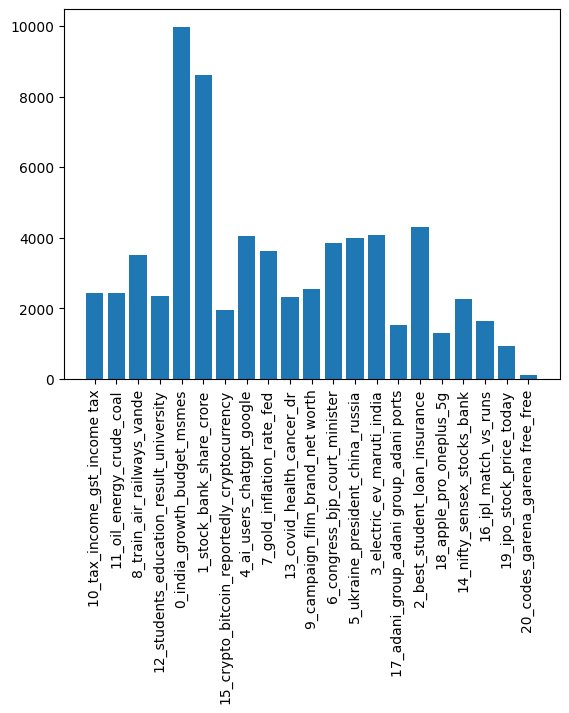

In [43]:
plt.bar(ind, list(num_points.values()))
plt.xticks(ind, list(num_points.keys()))
plt.xticks(rotation=90)
plt.savefig('kmeans_histogram.png', bbox_inches='tight')
plt.show()

## Using HDBSCAN

### Default clusters

In [44]:
folder_path = 'Embeddings/'
file = 'formatted_articles_data_2023_embeddings_bge_small_en.parquet'
ect_bge_small = EmbeddingsClusterTopics(model_name = 'BAAI/bge-small-en', 
                                        dataset_path = folder_path + file, 
                                        documents_column_name = 'title_summary',
                                        embeddings_column_name = 'embeddings', 
                                        clustering_type='hdbscan',
                                        random_state=86)

100%|██████████| 1161/1161 [00:07<00:00, 155.27it/s]


In [45]:
ect_bge_small.bertopic_model.visualize_topics()

In [46]:
num_points = {}
for k in ect_bge_small.bertopic_model.topics_:
    num_points[ect_bge_small.bertopic_model.topic_labels_[k]] = num_points.get(ect_bge_small.bertopic_model.topic_labels_[k],0) + 1

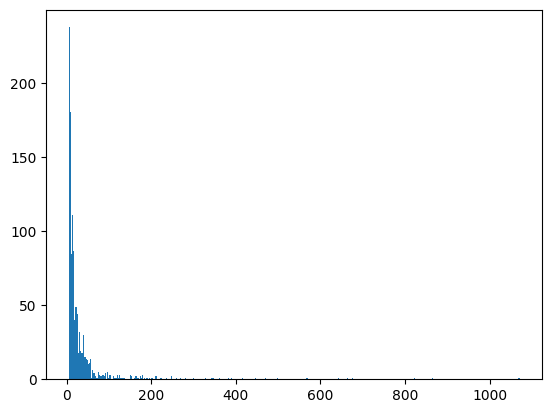

In [57]:
plt.hist(list(num_points.values())[1:],bins = 400)
plt.savefig('./plots/hdbscan_histogram.png', bbox_inches='tight')
plt.show()

### Outlier Analysis

In [59]:
100 * len([idx for idx, i in enumerate(ect_bge_small.bertopic_model.topics_) if i == -1])/len(ect_bge_small.bertopic_model.topics_)

40.35387287661554

### Outlier Reduction

In [60]:
new_topics = ect_bge_small.bertopic_model.reduce_outliers(ect_bge_small.documents, ect_bge_small.bertopic_model.topics_)

In [62]:
num_points = {}
for k in new_topics:
    num_points[ect_bge_small.bertopic_model.topic_labels_[k]] = num_points.get(ect_bge_small.bertopic_model.topic_labels_[k],0) + 1

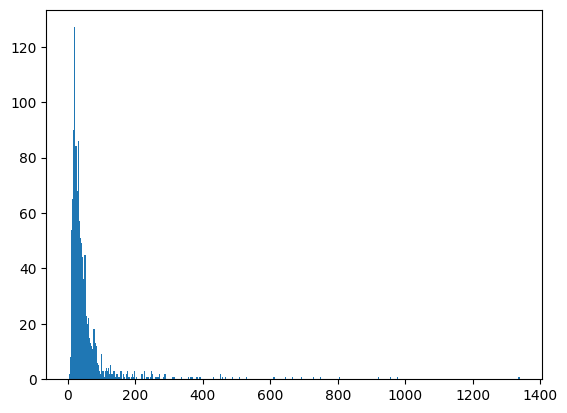

In [63]:
plt.hist(list(num_points.values())[1:],bins = 400)
plt.savefig('./plots/hdbscan_histogram_reduced_outliers.png', bbox_inches='tight')
plt.show()

In [64]:
ect_bge_small.bertopic_model.topics_ = new_topics

In [65]:
ect_bge_small.bertopic_model.visualize_topics()

In [111]:
# gte_hierarchy = deepcopy(ect_gte_small.hierarchical_topics)
bge_hierarchy = deepcopy(ect_bge_small.hierarchical_topics)

In [112]:
ect_bge_small.bertopic_model.visualize_hierarchy(hierarchical_topics=bge_hierarchy)

### Topic hierarchy & Levels

In [81]:
class TopicHierarchy:
    def __init__(self, df, topic_to_doc_indices):
        self.df = df
        # self.levels = {}
        self.raw_leaf_points_count = {}
        self.raw_leaf_points_list = {}
        self.topic_to_doc_indices = topic_to_doc_indices

    def compute_levels(self, parent_id, level, levels):
        levels[parent_id] = level
        children = self.df[self.df['Parent_ID'] == parent_id]

        for _, child in children.iterrows():
            self.compute_levels(child['Child_Left_ID'], level + 1, levels)
            self.compute_levels(child['Child_Right_ID'], level + 1, levels)

    def compute_raw_leaf_points(self, parent_id):
        if parent_id in self.raw_leaf_points_count:
            return self.raw_leaf_points_count[parent_id], self.raw_leaf_points_list[parent_id]

        children = self.df[self.df['Parent_ID'] == parent_id]

        if children.empty:
            parent_id_int = int(parent_id)
            if parent_id_int in self.topic_to_doc_indices:
                doc_indices = [idx for idx, x in enumerate(self.topic_to_doc_indices) if x == parent_id_int]
                count = len(doc_indices)
            else:
                count = 0
                doc_indices = []
            self.raw_leaf_points_count[parent_id] = count
            self.raw_leaf_points_list[parent_id] = doc_indices
            return count, doc_indices

        total_leaf_points = 0
        all_leaf_points = []

        for _, child in children.iterrows():
            left_count, left_list = self.compute_raw_leaf_points(child['Child_Left_ID'])
            right_count, right_list = self.compute_raw_leaf_points(child['Child_Right_ID'])

            total_leaf_points += left_count + right_count
            all_leaf_points.extend(left_list)
            all_leaf_points.extend(right_list)

        self.raw_leaf_points_count[parent_id] = total_leaf_points
        self.raw_leaf_points_list[parent_id] = all_leaf_points

        return total_leaf_points, all_leaf_points

    def get_levels(self):
        levels = {}
        all_child_ids = set(self.df['Child_Left_ID']).union(set(self.df['Child_Right_ID']))
        roots = self.df[~self.df['Parent_ID'].isin(all_child_ids)]
        for _, root in roots.iterrows():
            self.compute_levels(root['Parent_ID'], 0, levels)
        return levels

    def get_raw_leaf_points(self):
        roots = self.df[~self.df['Parent_ID'].isin(self.df['Child_Left_ID']) & ~self.df['Parent_ID'].isin(self.df['Child_Right_ID'])]
        for _, root in roots.iterrows():
            self.compute_raw_leaf_points(root['Parent_ID'])

        return self.raw_leaf_points_count, self.raw_leaf_points_list

In [92]:
def get_balanced_clusters(df, parent_id, max_points=4000):
    balanced_clusters = []
    cluster_row = df[df['Parent_ID'] == parent_id].iloc[0]
    num_points = cluster_row['num_points']

    if num_points <= max_points:
        balanced_clusters.append(cluster_row['Parent_ID'])
        return balanced_clusters

    children = df[df['Parent_ID'] == parent_id]

    for _, child in children.iterrows():
        balanced_clusters += get_balanced_clusters(df, child['Child_Left_ID'], max_points)
        balanced_clusters += get_balanced_clusters(df, child['Child_Right_ID'], max_points)

    return balanced_clusters

In [78]:
bge_topic_hierarchy = TopicHierarchy(bge_hierarchy, ect_bge_small.bertopic_model.topics_)
bge_levels = bge_topic_hierarchy.get_levels()
num_points, points = bge_topic_hierarchy.get_raw_leaf_points()

# Updating DataFrame as before
bge_hierarchy['Level'] = bge_hierarchy['Parent_ID'].map(bge_levels)
bge_hierarchy['num_points'] = bge_hierarchy['Parent_ID'].map(num_points)
bge_hierarchy['points'] = bge_hierarchy['Parent_ID'].map(points)

In [106]:
balanced_clusters = get_balanced_clusters(bge_hierarchy,parent_id = '2322', max_points = 8000)

In [107]:
len(balanced_clusters)

36

In [108]:
bge_hierarchy[bge_hierarchy.Parent_ID.isin(balanced_clusters)]

,Parent_ID,Parent_Name,Topics,Child_Left_ID,Child_Left_Name,Child_Right_ID,Child_Right_Name,Distance,Level,num_points,points
1155,2317,suzuki_maruti suzuki_maruti_oneplus_hero,"[39, 76, 119, 130, 132, 147, 150, 154, 172, 17...",2265,oneplus_galaxy_5g_samsung_samsung galaxy,2310,suzuki_maruti suzuki_maruti_hero_hyundai,1.728155,2,3189,"[13439, 15649, 16639, 17751, 18562, 18629, 383..."
1150,2312,airtel_bharti_bharti airtel_jio_dividend,"[22, 88, 122, 168, 176, 183, 188, 242, 260, 27...",2306,airtel_bharti_bharti airtel_jio_net profit,2141,exdividend_vedanta_interim dividend_dividend_i...,1.680273,5,1816,"[2211, 3814, 4119, 4418, 6881, 6999, 7240, 742..."
1147,2309,stock price_closed_yesterdays_closed today_pri...,"[61, 68, 83, 91, 120, 128, 145, 148, 149, 153,...",2303,stock price_closed_yesterdays_closed today_bajaj,2196,stock price_yesterdays_closed_closed today_pri...,1.601550,1,3635,"[1544, 1601, 1851, 4896, 4899, 5539, 8659, 126..."
1138,2300,diesel_gst_petrol_tax_crude,"[1, 3, 13, 18, 28, 29, 40, 57, 64, 66, 78, 82,...",2292,gst_tax_inflation_rupee_income tax,2193,diesel_petrol_petrol diesel_crude_oil,1.539070,9,7557,"[8228, 42996, 43473, 43481, 44532, 49478, 5074..."
1136,2298,chatgpt_ai_twitter_musk_openai,"[12, 15, 65, 136, 167, 259, 289, 429, 490, 585...",2086,chatgpt_ai_openai_chatbot_generative,2024,twitter_musk_elon_elon musk_blue,1.532645,7,1749,"[130, 377, 387, 428, 441, 653, 693, 917, 2127,..."
1127,2289,ukraine_putin_visit_balloon_biden,"[8, 30, 43, 56, 85, 90, 112, 117, 141, 241, 24...",2105,ukraine_putin_russia_russian_wagner,2272,balloon_visit_chinese_debt ceiling_china,1.477389,6,2903,"[4643, 4867, 6032, 11227, 18404, 22505, 22621,..."
1124,2286,cyclone_imd_rainfall_biparjoy_heavy,"[27, 75, 229, 320, 332, 370, 389, 394, 473, 48...",1311,sudan_khartoum_operation kaveri_kaveri_ceasefire,2267,cyclone_imd_rainfall_biparjoy_heavy,1.440177,16,1171,"[10791, 13199, 13895, 14099, 15617, 16044, 178..."
1123,2285,apple_iphone_cci_wwdc_apples,"[35, 106, 133, 198, 271, 408, 431, 488, 558, 7...",2276,cci_google_aditya birla_aditya_birla,2000,apple_iphone_wwdc_apples_ios,1.436139,17,918,"[1448, 5528, 5545, 6087, 7717, 10780, 12239, 1..."
1122,2284,crypto_bitcoin_cryptocurrency_blockchain_ftx,"[10, 87, 140, 158, 375, 387, 422, 586, 594, 61...",2268,crypto_bitcoin_cryptocurrency_blockchain_ftx,1313,korea_north korea_north_ballistic_missile,1.432185,11,1491,"[22576, 25756, 29459, 30747, 38278, 46656, 480..."
1119,2281,mutual_sip_mutual fund_mutual funds_screener,"[127, 129, 170, 207, 423, 522, 535, 916, 935, ...",1986,sip_mutual_mutual funds_mutual fund_funds,1417,screener_tracking_fund screener_tracking error...,1.411290,7,603,"[2114, 3437, 4459, 4476, 4788, 5459, 5473, 582..."


In [72]:
bge_hierarchy[bge_hierarchy.Level == 5].num_points.sum()

67796

In [ ]:
bge_hierarchy

In [79]:
bge_hierarchy

,Parent_ID,Parent_Name,Topics,Child_Left_ID,Child_Left_Name,Child_Right_ID,Child_Right_Name,Distance,Level,num_points,points
1160,2322,today_stock_closed_price_share,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",2309,stock price_closed_yesterdays_closed today_pri...,2321,nifty_rs_gold_rate_bank,2.703606,0,67932,"[1544, 1601, 1851, 4896, 4899, 5539, 8659, 126..."
1159,2321,nifty_rs_gold_rate_bank,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",2320,nifty_gold_rate_bank_sensex,2317,suzuki_maruti suzuki_maruti_oneplus_hero,2.117668,1,64297,"[2241, 2242, 2870, 3130, 3347, 3508, 3668, 486..."
1158,2320,nifty_gold_rate_bank_sensex,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",2116,ipo_gmp_ipo gmp_subscribed_subscription,2319,nifty_rate_gold_bank_sensex,2.022403,2,61108,"[2241, 2242, 2870, 3130, 3347, 3508, 3668, 486..."
1157,2319,nifty_rate_gold_bank_sensex,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",2316,nifty_sensex_gold_rate_stocks,2318,msmes_codes_student_president_student loan,1.868250,3,60519,"[9340, 15989, 26775, 26921, 26990, 27008, 2718..."
1156,2318,msmes_codes_student_president_student loan,"[0, 5, 6, 8, 9, 10, 11, 12, 15, 19, 20, 21, 23...",2314,msmes_codes_president_ipl_pm,2085,student loan_student_loan_forgiveness_loan for...,1.747823,4,41550,"[1706, 1746, 11255, 15182, 30899, 32424, 32442..."
...,...,...,...,...,...,...,...,...,...,...,...
4,1166,s23_galaxy s23_galaxy_samsung_samsung galaxy,"[130, 1045]",130,s23_galaxy s23_galaxy_samsung_samsung galaxy,1045,s23_galaxy s23_galaxy_galaxy s22_s22,0.325869,6,87,"[3022, 9190, 12415, 12530, 12693, 12832, 12911..."
3,1165,harleydavidson_x440_harleydavidson x440_motorc...,"[526, 748]",748,x440_harleydavidson x440_harleydavidson_honda ...,526,harleydavidson_x440_harleydavidson x440_harley...,0.289614,6,36,"[14359, 35732, 35960, 36843, 37383, 41212, 428..."
2,1164,bgmi_bgmi redeem_redeem codes_redeem_ingame,"[434, 642]",642,bgmi_bgmi redeem_redeem codes_redeem_ingame,434,bgmi_battlegrounds mobile_mobile india_battleg...,0.263188,13,43,"[6612, 15162, 15198, 15639, 16108, 16259, 1650..."
1,1163,vaishali parekh_vaishali_parekh_buy today_pare...,"[96, 342]",342,vaishali parekh_parekh_vaishali_believes vaish...,96,vaishali_vaishali parekh_parekh_buy today_buy ...,0.208726,8,137,"[13437, 17459, 23242, 25584, 25680, 26099, 265..."


In [73]:
bge_hierarchy[bge_hierarchy.Level == 5]

,Parent_ID,Parent_Name,Topics,Child_Left_ID,Child_Left_Name,Child_Right_ID,Child_Right_Name,Distance,Level,num_points,points
1153,2315,nifty_sensex_gold_rate_bank nifty,"[1, 2, 3, 4, 7, 13, 14, 16, 17, 18, 28, 29, 40...",2055,buy sell_day trading_stocks buy_buy today_vais...,2313,nifty_sensex_gold_rate_bank nifty,1.700893,5,17153,"[9340, 15989, 26775, 26921, 26990, 27008, 2718..."
1152,2314,msmes_codes_president_ipl_pm,"[0, 5, 6, 8, 9, 10, 11, 12, 15, 19, 20, 23, 24...",2311,msmes_codes_ipl_redeem_chatgpt,2289,ukraine_putin_visit_balloon_biden,1.697032,5,40981,"[1706, 1746, 11255, 15182, 30899, 32424, 32442..."
1150,2312,airtel_bharti_bharti airtel_jio_dividend,"[22, 88, 122, 168, 176, 183, 188, 242, 260, 27...",2306,airtel_bharti_bharti airtel_jio_net profit,2141,exdividend_vedanta_interim dividend_dividend_i...,1.680273,5,1816,"[2211, 3814, 4119, 4418, 6881, 6999, 7240, 742..."
1118,2280,stock price_closed_yesterdays_closed today_nestle,"[91, 149, 163, 165, 174, 180, 181, 185, 193, 1...",2260,stock price_nestle_lt_closed_yesterdays,2234,axis bank_icici bank_icici_axis_bank stock,1.404427,5,1599,"[10077, 10142, 10624, 11265, 11574, 44459, 455..."
1107,2269,hero_hero motor_motor_s1_motor stock,"[210, 261, 391, 395, 428, 453, 475, 581, 616, ...",2192,hero_hero motor_motor_motor stock_pulsar,1968,s1_ola_ather_electric scooter_scooter,1.374955,5,500,"[14672, 15020, 15124, 39723, 40743, 43945, 444..."
1104,2266,maruti suzuki_maruti_suzuki_jimny_fronx,"[76, 132, 172, 255, 267, 441, 534, 626, 647, 7...",2134,maruti suzuki_maruti_suzuki_toyota_cng,1675,jimny_suzuki jimny_thar_mahindra thar_mahindra,1.366018,5,530,"[98, 6251, 6873, 7141, 8034, 9771, 11222, 1406..."
1086,2248,hyundai_kia_suv_verna_facelift,"[150, 173, 215, 270, 275, 279, 298, 313, 331, ...",2233,hyundai_verna_bmw_hyundai verna_suv,1777,kia_seltos_kia seltos_elevate_honda elevate,1.313133,5,1038,"[552, 2974, 3470, 11281, 14602, 14641, 14697, ..."
1027,2189,enfield_royal enfield_royal_triumph_harleydavi...,"[239, 312, 526, 573, 748]",1459,enfield_royal enfield_royal_triumph_meteor,1165,harleydavidson_x440_harleydavidson x440_motorc...,1.208829,5,171,"[13736, 14507, 14649, 14781, 14810, 14911, 149..."
923,2085,student loan_student_loan_forgiveness_loan for...,"[21, 144, 440, 476, 499, 579, 1037]",1717,student loan_student_forgiveness_loan forgiven...,1327,aid programs_financial aid_loan financial_aid_...,1.111374,5,569,"[1018, 2737, 9094, 9430, 28373, 31936, 31943, ..."
774,1936,pixel_google pixel_7a_pixel 7a_phone,"[119, 204, 382, 693, 788]",1570,smartphones_best smartphones_smartphones buy_b...,1701,pixel_google pixel_pixel 7a_7a_phone,1.017987,5,245,"[7105, 8134, 13363, 15360, 15596, 16580, 17284..."


In [69]:
bge_hierarchy.groupby('Level')['Level'].count()

Level
0      1
1      2
2      4
3      8
4     14
5     26
6     34
7     40
8     45
9     44
10    39
11    37
12    41
13    42
14    38
15    44
16    37
17    40
18    44
19    42
20    46
21    36
22    46
23    49
24    41
25    27
26    11
27    13
28    17
29    23
30    19
31    23
32    19
33    13
34    11
35    10
36    12
37    18
38    20
39    12
40     9
41    12
42     9
43     8
44     7
45     9
46     8
47     5
48     2
49     2
50     2
Name: Level, dtype: int64

### Using approximate distributions

In [22]:
bge_small_topic_dist, _ = ect_bge_small.bertopic_model.approximate_distribution(ect_bge_small.documents)

In [23]:
bge_small_topic_dist[0]

array([0., 0., 0., ..., 0., 0., 0.])

In [24]:
max(bge_small_topic_dist[0])

0.40338707406072455

In [25]:
index = 0
[(i, idx) for idx, i in enumerate(bge_small_topic_dist[index]) if i == max(bge_small_topic_dist[index])]

[(0.40338707406072455, 1079)]

In [28]:
ect_bge_small.documents[4]

'Who is Piyush Gupta, the CEO of DBS Group who earns Rs  lakh per day? Know about his education, family, net worth & more DBS Group chief executive Piyush Gupta saw his annual earnings climb  per cent to SGD  million in '

In [ ]:
ect_bge_small

In [75]:
ect_bge_small.bertopic_model.representative_docs_[20]

['ITR e-filing Start Date : When you can file Income Tax Return for AY - e-filing ITR start date  (AY -): The Income Tax Return (ITR) e-filing for Assessment Year - (FY -) is expected to start soon. ',
 'Income tax return filing | Online ITR , ITR  forms available now: Know who should use these Income taxpayers can now file their returns for AY - through Income Tax Return (ITR) forms ITR- and ITR- on the e-filing portal. Read this to check eligibility',
 'Income Tax Return (ITR) e-filing for AY -: ITR-, ITR- enabled filing in online mode Income Tax Return (ITR) filing online for Assessment Year -: Taxpayers can now file returns for AY - through Income Tax Return (ITR) forms ITR- and ITR-']

In [67]:
ect_bge_small.bertopic_model.topic_labels_[1749]

'1749_unstoppable_nyse_domains_binance'

In [ ]:
ect_bge_small.bertopic_model.approximate_distribution(ect_bge_small.documents)

In [23]:
bge_topic_embeddings = ect_bge_small.bertopic_model.topic_embeddings_

In [129]:
gte_hierarchy_head = gte_hierarchy.head(3)

In [142]:
# Assume you have a DataFrame gte_hierarchy and a topic-to-doc mapping topic_to_doc_indices
gte_topic_hierarchy = TopicHierarchy(gte_hierarchy, ect_gte_small.bertopic_model.topics_)
gte_levels = gte_topic_hierarchy.get_levels()
num_points, points = gte_topic_hierarchy.get_raw_leaf_points()

# Updating DataFrame as before
gte_hierarchy['Level'] = gte_hierarchy['Parent_ID'].map(gte_levels)
gte_hierarchy['num_points'] = gte_hierarchy['Parent_ID'].map(num_points)
gte_hierarchy['points'] = gte_hierarchy['Parent_ID'].map(points)

In [55]:
# Assume you have a DataFrame gte_hierarchy and a topic-to-doc mapping topic_to_doc_indices
# bge_topic_hierarchy = TopicHierarchy(bge_hierarchy, ect_bge_small.bertopic_model.topics_)
bge_topic_hierarchy = TopicHierarchy(bge_hierarchy, ect_bge_small.bertopic_model.topics_)
bge_levels = bge_topic_hierarchy.get_levels()
num_points, points = bge_topic_hierarchy.get_raw_leaf_points()

# Updating DataFrame as before
bge_hierarchy['Level'] = bge_hierarchy['Parent_ID'].map(bge_levels)
bge_hierarchy['num_points'] = bge_hierarchy['Parent_ID'].map(num_points)
bge_hierarchy['points'] = bge_hierarchy['Parent_ID'].map(points)

In [200]:
new_topics = ect_bge_small.bertopic_model.reduce_outliers(ect_bge_small.documents, ect_bge_small.bertopic_model.topics_)

In [211]:
ect_bge_small.bertopic_model.reduce_topics(ect_bge_small.documents, nr_topics='auto')

In [213]:
max(ect_bge_small.bertopic_model.topics_)

1056

In [203]:
len([idx for idx, i in enumerate(new_topics) if i == -1])

0

In [47]:
bge_hierarchy['num_topics'] = bge_hierarchy['Topics'].apply(lambda x: len(x))

In [63]:
bge_hierarchy.groupby('Level')['Level'].count()

Level
0    1
1    2
2    3
3    3
4    4
5    3
6    2
7    1
8    1
9    1
Name: Level, dtype: int64

In [87]:
x = bge_small_topic_dist[4]
sum_1 = [x[i] for i in bge_hierarchy[bge_hierarchy.Level == 5].iloc[0].Topics]

In [92]:
sums = {}

In [99]:
for i in range(len(bge_hierarchy[bge_hierarchy.Level == 5])):
    sums[i] = np.sum([x[k] for k in bge_hierarchy[bge_hierarchy.Level == 5].iloc[i].Topics])

In [102]:
total_topics = 0
for i in range(len(bge_hierarchy[bge_hierarchy.Level == 5])):
    total_topics += len(bge_hierarchy[bge_hierarchy.Level == 5].iloc[i].Topics)

In [ ]:
from hdbscan import HDBSCAN

In [ ]:
heirarchy_df_bge = deepcopy(ect_bge_small.hierarchical_topics)

In [ ]:
topic_hierarchy = TopicHierarchy(heirarchy_df_bge)
# Compute the levels
levels = topic_hierarchy.get_levels()

# Add a new 'Level' column to the DataFrame
heirarchy_df_bge['Level'] = heirarchy_df_bge['Parent_ID'].map(levels)

In [ ]:
heirarchy_df_bge.groupby('Level')['Parent_ID'].nunique()

Level
0    431
1    220
2    103
3     43
4     24
5      6
6      3
7      2
8      1
9      1
Name: Parent_ID, dtype: int64

In [ ]:
heirarchy_df_bge['num_topics'] = heirarchy_df_bge['Topics'].apply(lambda x: len(x))

In [ ]:
topic_hierarchy = TopicHierarchy(heirarchy_df)

In [ ]:
heirarchy_df['num_topics'] = heirarchy_df['Topics'].apply(lambda x: len(x))

In [ ]:
heirarchy_df.head(3)

,Parent_ID,Parent_Name,Topics,Child_Left_ID,Child_Left_Name,Child_Right_ID,Child_Right_Name,Distance,num_topics
941,1884,today_stock_price_closed_share,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",1876,closed_yesterdays_stock_reacts_monitor,1883,nifty_on_us_gold_of,4.015382,943
940,1883,nifty_on_us_gold_of,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",1745,codes_redeem_garena_max_fire,1882,nifty_on_us_gold_of,2.761833,837
939,1882,nifty_on_us_gold_of,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",1174,petrol_diesel_retailing_litre_cities,1881,nifty_on_us_gold_of,2.661238,827


In [ ]:
from nltk.corpus import stopwords

In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS

def generate_topic_name(documents, global_documents):
    # Create a bag of words representation for the global set of documents
    english_stop_words = list(set(stopwords.words('english')))

    vectorizer = CountVectorizer(stop_words=english_stop_words)
    global_bow = vectorizer.fit_transform(global_documents)

    # Create a bag of words representation for the given set of documents
    document_bow = vectorizer.transform(documents)

    # Calculate term frequency (TF) for each word in the given set
    document_tf = document_bow.sum(axis=0)

    feature_names = vectorizer.get_feature_names_out()

    # Compare TF values against the global set and select relatively frequent words
    selected_words = []
    for word, tf_value in zip(feature_names, document_tf.tolist()[0]):
        global_tf = global_bow.getcol(vectorizer.vocabulary_[word]).sum()
        if tf_value > global_tf:
            selected_words.append(word)

    # Combine selected words to create a topic name
    topic_name = ' '.join(selected_words)
    return topic_name

# Example usage
global_documents = ["global document 1", "global document 2", "global document 3"]
documents_to_classify = ["document to classify 1", "document to classify 2"]

topic_name = generate_topic_name(documents_to_classify, global_documents)
print("Generated Topic Name:", topic_name)

Generated Topic Name: 


In [ ]:
cluster_idx = [idx for idx, val in enumerate(ect.bertopic_model.topics_) if val == 656]

In [ ]:
cluster_docs = [ect.documents[idx] for idx in cluster_idx]

In [ ]:
cluster_docs

['M&M sets record date for stock option for MEML shareholders: Check here The company will allot  ordinary equity shares of face value of   each for every , equity shares of MEML of   each.',
 "M&M share price Today Live Updates : M&M closed today at  , up 1.01% from yesterday's   M&M stock price went up today,  Jun , by  %. The stock closed at  per share. The stock is currently trading at  per share. Investors should monitor M&M stock price closely in the coming days and weeks to see how it reacts to the news.",
 'M&M Share Price Live blog for  Jul  M&M stock price went up today,  Jul , by  %. The stock closed at  per share. The stock is currently trading at  per share. Investors should monitor M&M stock price closely in the coming days and weeks to see how it reacts to the news.',
 "M&M closed today at  , up 0.34% from yesterday's   M&M stock price went up today,  May , by  %. The stock closed at  per share. The stock is currently trading at  per share. Investors should monitor M&M s

In [ ]:
ect_bge_small.bertopic_model.visualize_topics()

In [ ]:
ect.bertopic_model.visualize_topics()

In [ ]:
ect.bertopic_model.visualize_topics()

In [ ]:
ect.bertopic_model.visualize_topics()

In [ ]:
ect1.bertopic_model.visualize_hierarchy()